## SmallVAE

SmallVAE is smaller VAE model that can be 

In [1]:
import magenta.music as mm
from magenta.models.music_vae import configs
from magenta.models.music_vae.trained_model import TrainedModel
import numpy as np
import os
import tensorflow as tf
from tensorflow import keras
import pretty_midi
import matplotlib.pyplot as plt 


def play(note_sequence):
    mm.play_sequence(note_sequence)


Define the parameter dictionary:

In [2]:
class ParamDict(dict):
    __setattr__ = dict.__setitem__
    def __getattr__(self, attr):
        try:
            return self.__getitem__(attr)
        except KeyError:
            raise AttributeError("Attribute %r not found" % attr)
    def __getstate__(self): return self
    def __setstate__(self, d): self = d

Define the VAE structure:

In [3]:
MODEL_PARAMS = ParamDict(
    epoches = 500,
    input_dim = 512,
    latent_dim = 4,
    latent_loss_covarience = 1,
    learning_rate=0.0001,
    record_per_epoch = 10,
)

In [10]:
from tensorflow.contrib.slim import fully_connected as fc

class SmallVAE(object):
    def __init__(self, param):
        self.param = param
        self.train_record_Encoder = []
        
        tf.reset_default_graph()
        self.X = tf.placeholder(tf.float32, [None, self.param.input_dim])
        
        # Encoder network
        e1 = fc(self.X, 1024, activation_fn=tf.nn.relu)
        e2 = fc(e1, 256, activation_fn=tf.nn.relu)
        e3 = fc(e2, 64, activation_fn=tf.nn.relu)
        
        # Reparameter
        self.z_mu = fc(e3, self.param.latent_dim, activation_fn=None)
        self.z_log_sigma_sq = fc(e3, self.param.latent_dim, activation_fn=None)
        eps = tf.random_normal(
            shape=tf.shape(self.z_log_sigma_sq),
            mean=0, stddev=1, dtype=tf.float32)
        self.z = self.z_mu + tf.sqrt(tf.exp(self.z_log_sigma_sq)) * eps
        
        # Decoder network
        d1 = fc(self.z, 64, activation_fn=tf.nn.relu)
        d2 = fc(d1, 256, activation_fn=tf.nn.relu)
        d3 = fc(d2, 1024, activation_fn=tf.nn.relu)
        
        self.x_hat = fc(d3, self.param.input_dim, activation_fn=tf.sigmoid)
        
        self.loss = self._loss(self.z_mu, self.z_log_sigma_sq, self.x_hat, self.X)
    
        # Optimizer
        self.optimizer = tf.train.AdamOptimizer(learning_rate=self.param.learning_rate).minimize(self.loss)

        # Initialize paramters
        self.sess = tf.InteractiveSession()
        self.sess.run(tf.global_variables_initializer())
    
    def _loss(self, zMu, zSigma, yPred, yTrue):
        latentLoss = self._klLoss(zMu, zSigma)
        reconLoss = self._reconstructionLoss(yPred, yTrue)
        totalLoss = reconLoss + latentLoss * self.param.latent_loss_covarience
        return totalLoss
    
    def _klLoss(self, mu, sigma):
        mu2 = mu**2
        sigma2 = sigma**2
        term1 = tf.log(sigma2) + 1
        term2 = mu2 + sigma2
        term = term1 - term2
        div = tf.reduce_mean(tf.reduce_sum(term, -1)) / 2
        return -div
        
    def _reconstructionLoss(self, yPred, yTrue):
        se = (yTrue - yPred) ** 2
        nll = se / (2 * tf.pow(tf.ones([1]), 2))
        return tf.reduce_mean(tf.reduce_sum(nll, -1))
        
    def train(self, inputs):
        print('-' * 5 + '  Start training  ' + '-' * 5)
        for epoch in range(self.param.epoches):
            #Create Progressbar
            progbar = keras.utils.Progbar(self.param.epoches)
            
            #Train
            feed_dict = {self.X: inputs}
            fetches = [self.optimizer, self.loss]
            _, loss = self.sess.run(fetches, feed_dict=feed_dict)
            
            #Show Progress
            progbar.update(epoch, values=[('loss', loss)])
            if epoch % self.param.record_per_epoch == 0:   #save traing loss every 20 epoches
                self.train_record_Encoder.append(loss)
        self.plot_training()
        print('\ntrain_Encoder complete!')
        
    def predict(self, input_latent_vector):
        feed_dict = {self.X: inputs}
        fetches = [self.x_hat]
        return self.sess.run(fetches, feed_dict=feed_dict)
    
    def sample(self, model):
        randZs = np.random.normal(size=(1, self.param.latent_dim))
        feed_dict = {self.z: randZs}
        fetches = [self.x_hat]
        sample = self.sess.run(fetches, feed_dict=feed_dict)
        return model.decode(sample[0], length=64)
    
    def plot_training(self):
        plt.plot(range(0, self.param.epoches, self.param.record_per_epoch), self.train_record_Encoder)
        plt.xlabel('epoch')
        plt.ylabel('loss')
        plt.suptitle('Training loss (First Stage)')
        plt.show()
        

Restore pretrained MusicVAE (hierdec-mel_16bar):

In [5]:
hierdec_mel_16bar_config = configs.CONFIG_MAP['hierdec-mel_16bar']
mel_16bar = TrainedModel(
    hierdec_mel_16bar_config, batch_size=4, checkpoint_dir_or_path='./pretrain_model/hierdec-mel_16bar.ckpt')



INFO:tensorflow:Building MusicVAE model with BidirectionalLstmEncoder, HierarchicalLstmDecoder, and hparams:
{'max_seq_len': 256, 'z_size': 512, 'free_bits': 256, 'max_beta': 0.2, 'beta_rate': 0.0, 'batch_size': 4, 'grad_clip': 1.0, 'clip_mode': 'global_norm', 'grad_norm_clip_to_zero': 10000, 'learning_rate': 0.001, 'decay_rate': 0.9999, 'min_learning_rate': 1e-05, 'conditional': True, 'dec_rnn_size': [1024, 1024], 'enc_rnn_size': [2048, 2048], 'dropout_keep_prob': 1.0, 'sampling_schedule': 'constant', 'sampling_rate': 0.0, 'use_cudnn': False, 'residual_encoder': False, 'residual_decoder': False}

INFO:tensorflow:
Encoder Cells (bidirectional):
  units: [2048, 2048]


Instructions for updating:
This class is equivalent as tf.keras.layers.StackedRNNCells, and will be replaced by that in Tensorflow 2.0.
INFO:tensorflow:
Hierarchical Decoder:
  input length: 256
  level output lengths: [16, 16]



INFO:tensorflow:
Decoder Cells:
  units: [1024, 1024]



Instructions for updating:
Use ke

Load one sample:

In [6]:
midi_data = pretty_midi.PrettyMIDI('./midi/forest.mid')
proto = mm.midi_to_sequence_proto(midi_data)
play(proto)

Data preparation:

In [7]:
ns = hierdec_mel_16bar_config.data_converter.to_notesequences(
    hierdec_mel_16bar_config.data_converter.to_tensors(proto)[1])

z = mel_16bar.encode(ns)

-----  Start training  -----
499/500 [============================>.] - ETA: 0s - loss: 74.1727300

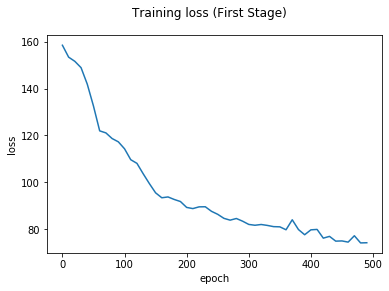


train_Encoder complete!


In [11]:
vae = SmallVAE(MODEL_PARAMS)
z_list = []
for i in z:
    for j in i:
        z_list.append(j)
vae.train(z_list)

In [13]:
import magenta.music.midi_io as io

In [18]:
small_vae_sample = vae.sample(mel_16bar)
for ns in small_vae_sample:
    play(ns)
    midi_data = io.note_sequence_to_pretty_midi(ns)
    midi_data.write('./samples/sample_smallVAE.mid')

In [15]:
music_vae_sample = mel_16bar.sample(n=4, length=64)
i=0
for ns in music_vae_sample:
    play(ns)
    midi_data = io.note_sequence_to_pretty_midi(ns)
    midi_data.write('./samples/sample_musicVAE%d.mid' % i)
    i+=1